## Loading packages

In [1]:
import matplotlib.pyplot as plt  # used for plotting
import numpy as np               # used for calculations
import pandas as pd              # used for data handling
import seaborn as sns            # used for plotting
import sklearn.tree as skt       # used for decision tree modeling

## Loading the dataset

The dataset is available online in form of a zipped `csv` file.
Source: AI4I 2020 Predictive Maintenance Dataset [Dataset]. (2020). UCI Machine Learning Repository. https://doi.org/10.24432/C5HS5C.

In [2]:
df = pd.read_csv("https://archive.ics.uci.edu/static/public/601/ai4i+2020+predictive+maintenance+dataset.zip")

## Quick check data integrity

It is always good practice to check the integrity of the dataset before performing any analysis.
This includes checking for missing values, duplicate entries, ensuring that the data types are appropriate for each feature, and looking at simple statistics.

In [3]:
df

,UDI,Product ID,Type,Air temperature [K],Process temperature [K],Rotational speed [rpm],Torque [Nm],Tool wear [min],Machine failure,TWF,HDF,PWF,OSF,RNF
0,1,M14860,M,298.1,308.6,1551,42.8,0,0,0,0,0,0,0
1,2,L47181,L,298.2,308.7,1408,46.3,3,0,0,0,0,0,0
2,3,L47182,L,298.1,308.5,1498,49.4,5,0,0,0,0,0,0
3,4,L47183,L,298.2,308.6,1433,39.5,7,0,0,0,0,0,0
4,5,L47184,L,298.2,308.7,1408,40.0,9,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9995,9996,M24855,M,298.8,308.4,1604,29.5,14,0,0,0,0,0,0
9996,9997,H39410,H,298.9,308.4,1632,31.8,17,0,0,0,0,0,0
9997,9998,M24857,M,299.0,308.6,1645,33.4,22,0,0,0,0,0,0
9998,9999,H39412,H,299.0,308.7,1408,48.5,25,0,0,0,0,0,0


Just displaying a couple of rows is useful for quickly inspecting the data structure and see if the dataset was correctly ex- and imported.

A few remarks:
- `UDI` appears to be some sort of linear step counter.
- Apparently, `Product ID` also seems to be a unique identifier.
- Interestingly, `Rotational speed` is represented as an integer (rpm), which is a discrete value, while `Torque` and `Tool wear` are continuous values.
- The target variables are binary indicators of failure types, represented as integers ($0$ or $1$).
- The dataset contains 10.000 rows and 14 columns.

In [4]:
df.isna().sum()

UDI                        0
Product ID                 0
Type                       0
Air temperature [K]        0
Process temperature [K]    0
Rotational speed [rpm]     0
Torque [Nm]                0
Tool wear [min]            0
Machine failure            0
TWF                        0
HDF                        0
PWF                        0
OSF                        0
RNF                        0
dtype: int64

In [5]:
df.duplicated().sum()

np.int64(0)

`isna` detects missing values in the dataframe and `duplicated` checks for duplicate entries.
The dataset appears to be clean, with no missing values or duplicates detected.

In [6]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
UDI,10000.0,5000.50000,2886.895680,1.0,2500.75,5000.5,7500.25,10000.0
Air temperature [K],10000.0,300.00493,2.000259,295.3,298.30,300.1,301.50,304.5
Process temperature [K],10000.0,310.00556,1.483734,305.7,308.80,310.1,311.10,313.8
Rotational speed [rpm],10000.0,1538.77610,179.284096,1168.0,1423.00,1503.0,1612.00,2886.0
Torque [Nm],10000.0,39.98691,9.968934,3.8,33.20,40.1,46.80,76.6
Tool wear [min],10000.0,107.95100,63.654147,0.0,53.00,108.0,162.00,253.0
Machine failure,10000.0,0.03390,0.180981,0.0,0.00,0.0,0.00,1.0
TWF,10000.0,0.00460,0.067671,0.0,0.00,0.0,0.00,1.0
HDF,10000.0,0.01150,0.106625,0.0,0.00,0.0,0.00,1.0
PWF,10000.0,0.00950,0.097009,0.0,0.00,0.0,0.00,1.0


`describe` provides a summary of the numerical features in the dataset, including count, mean, standard deviation, min, max, and quartiles.

There are no obvious outliers or anomalies in the data based on this summary.

In [7]:
df.dtypes

UDI                          int64
Product ID                  object
Type                        object
Air temperature [K]        float64
Process temperature [K]    float64
Rotational speed [rpm]       int64
Torque [Nm]                float64
Tool wear [min]              int64
Machine failure              int64
TWF                          int64
HDF                          int64
PWF                          int64
OSF                          int64
RNF                          int64
dtype: object

`dtypes` provides the data types of each feature in the dataset.

`object` types are typically storing `text data`.
Here are no additional surprises, as we already noticed the oddities previously.

In [8]:
df.nunique()

UDI                        10000
Product ID                 10000
Type                           3
Air temperature [K]           93
Process temperature [K]       82
Rotational speed [rpm]       941
Torque [Nm]                  577
Tool wear [min]              246
Machine failure                2
TWF                            2
HDF                            2
PWF                            2
OSF                            2
RNF                            2
dtype: int64

`nunique` counts the number of unique values in each feature.

We can clearly see that `UDI` is a unique identifier indeed, as it has a count equal to the number of rows in the dataset.
Obviously `Product ID` is another unique identifier, which most likely does not add anything useful for the analysis.
We also observe that `Type` indeed only contains `L`, `M`, and `H`.
And last, we observe that all the error types are indeed binary (as expected).

For digging deeper, we now define two global lists for accessing continuous and error variables more easily throughout the notebook.

In [9]:
CONTINUOUS_VARS = ['Air temperature [K]', 'Process temperature [K]', 'Rotational speed [rpm]', 'Torque [Nm]', 'Tool wear [min]']
ERROR_VARS = ['Machine failure', 'TWF', 'HDF', 'PWF', 'OSF', 'RNF']

In [10]:
df[ERROR_VARS].sum()

Machine failure    339
TWF                 46
HDF                115
PWF                 95
OSF                 98
RNF                 19
dtype: int64

Out of 10.000 rows, we have 339 rows that correspond to machine failures.
This corresponds to 3.39% of the dataset and is a clear indication of class imbalance.

Luckily we also have access to information of specific error types, which makes it easier to explore.

## Exploring continuous variables by simple plots

Here, we visualize the continuous variables (one by one) against the UDI (Unique Device Identifier) to get an idea of their temporal behavior.

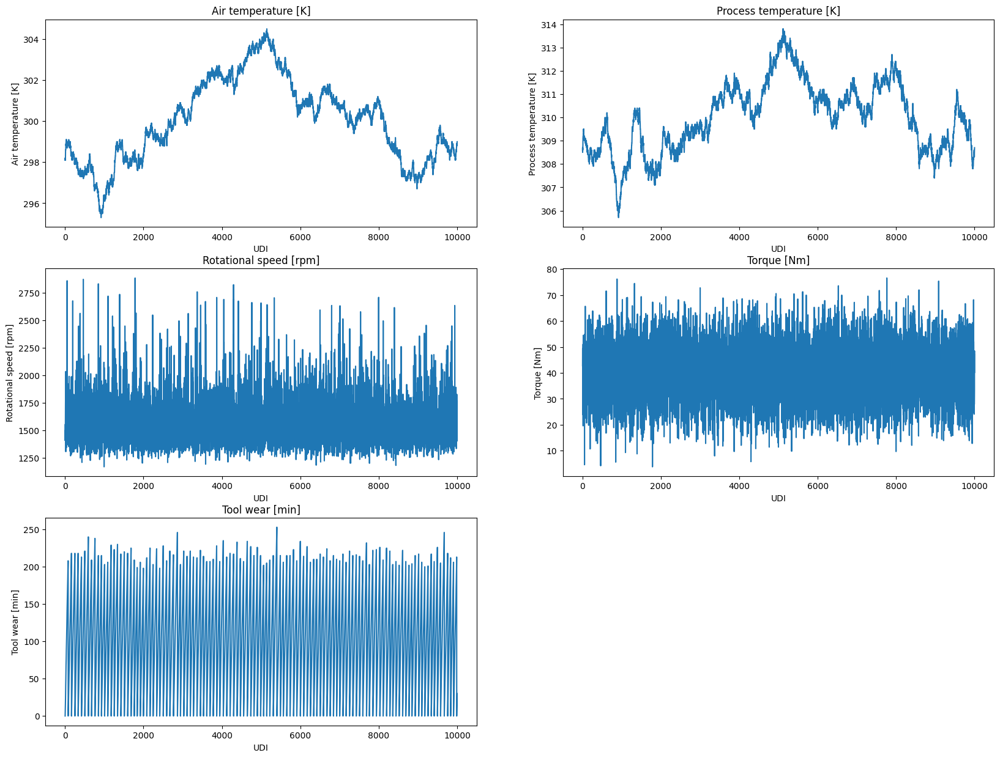

In [11]:
plt.figure(figsize=(20, 15))

for i, col in enumerate(CONTINUOUS_VARS, 1):
    plt.subplot((len(CONTINUOUS_VARS) + 1) // 2, 2, i)
    sns.lineplot(data=df, x="UDI", y=col)
    plt.title(f'{col}')

Remember that we are working with a dataset that contains three process types?
Let us explore, whether the distributions of the continuous variables differ across these process types.

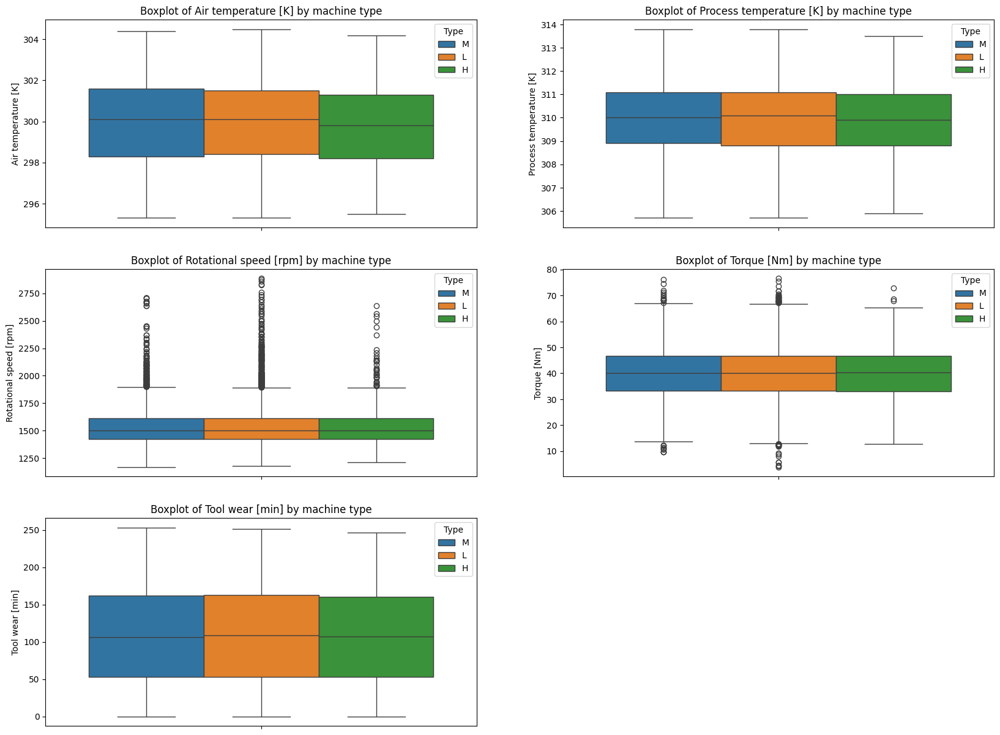

In [12]:
plt.figure(figsize=(20, 15))

for i, col in enumerate(CONTINUOUS_VARS, 1):
    plt.subplot((len(CONTINUOUS_VARS) + 1) // 2, 2, i)
    sns.boxplot(data=df, y=col, hue='Type')
    plt.title(f'Boxplot of {col} by machine type')

Apparently, there are only very little differences between the three process types.

Last, we will check for correlations between the variables.

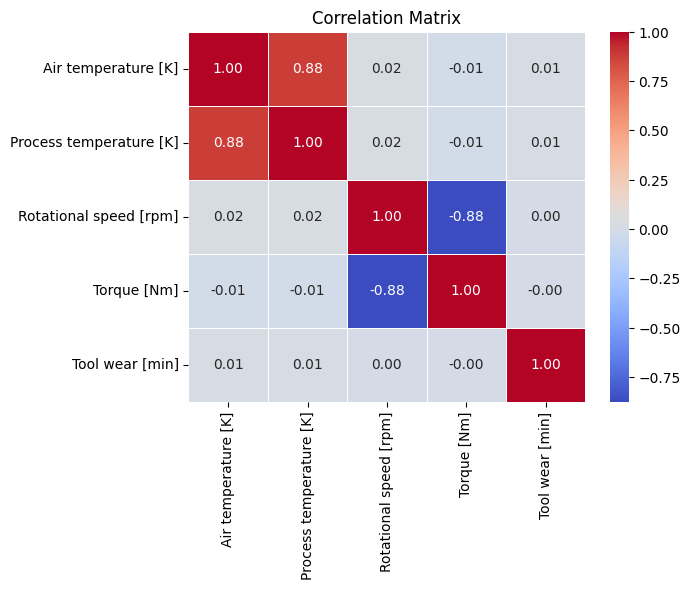

In [13]:
correlation_matrix = df[CONTINUOUS_VARS].corr()
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt='.2f', linewidths=0.5)
plt.title('Correlation Matrix');

The correlation matrix reveals:
- Air temperature and process temperature are highly positively correlated, indicating that as one increases, the other tends to increase as well.
- Rotational speed and torque are negatively correlated, meaning that as rotational speed increases, torque tends to decrease and vice versa.

`seaborn` provides a convenient way to visualize important characteristics of the dataset using the`pairplot` function.
The diagonal subplots show the distribution of each variable, while the off-diagonal subplots show the relationships between variables.

We included the `UDI` to have a temporal reference, allowing us to observe how the variables change over time (compare to the previous time series plots).
We can also clearly see the correlating variables in this pairplots.

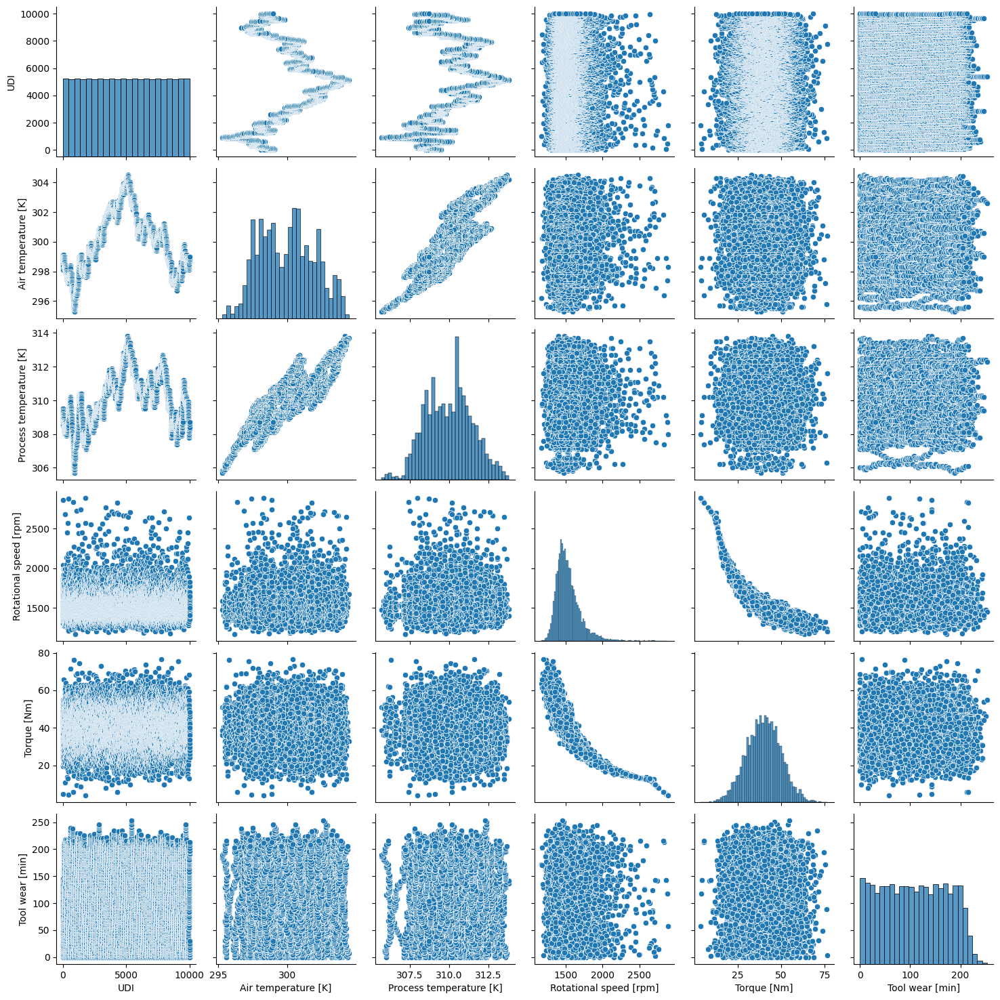

In [14]:
sns.pairplot(df, vars=["UDI"] + CONTINUOUS_VARS)

## Feature Engineering

Sometimes, it is easy to create new, meaningful features from the existing ones.
Often, process engineers have a deep understanding of the domain and can identify potential new features that may improve model performance.
So talking is key!

We will engineer two new features:
- **Temperature difference** between process and ambient temperature.
- **Power** is calculated as `Torque * Rotational Speed * 2 * pi`, where torque comes in Nm and rotational speed should be in revolutions per second. 

In [15]:
df.loc[:, "temp_diff"] = df["Process temperature [K]"] - df["Air temperature [K]"]
df.loc[:, "power"] = df["Torque [Nm]"] * 2 * np.pi * (df["Rotational speed [rpm]"] / 60)

## Investigating machine failures

It is easily possible to add another dimension to the visualizations.
For example, let us compare the distribution of the continuous variables by machine failures.

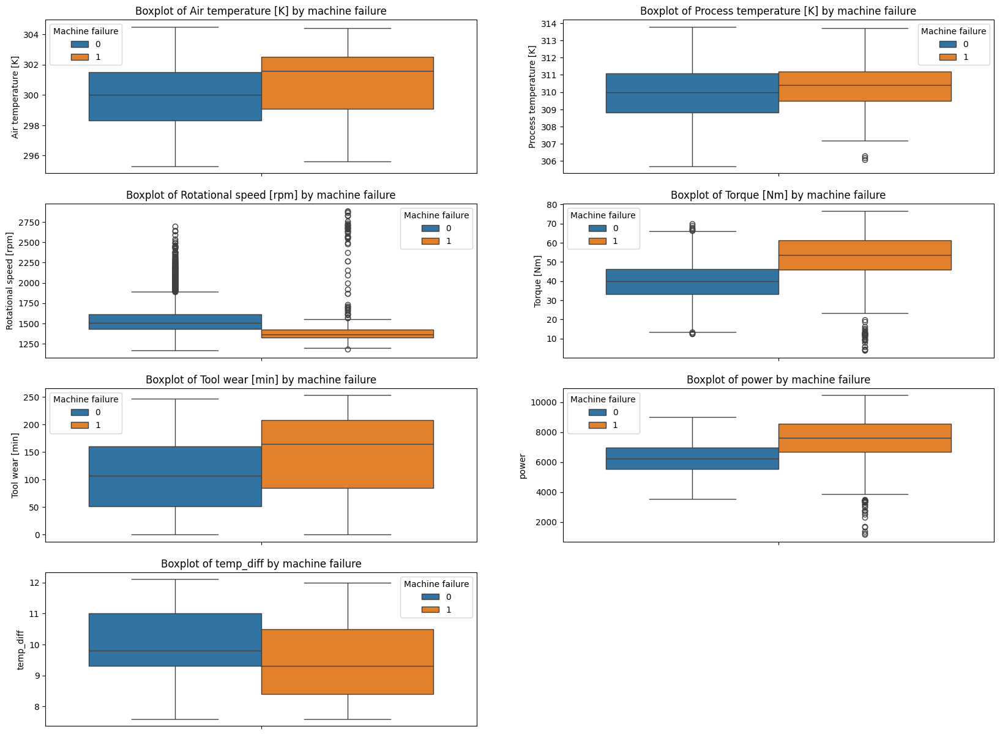

In [16]:
CONTINUOUS_VARS_ENG = CONTINUOUS_VARS + ["power", "temp_diff"]

plt.figure(figsize=(20, 15))

for i, col in enumerate(CONTINUOUS_VARS_ENG, 1):
    plt.subplot((len(CONTINUOUS_VARS_ENG) + 1) // 2, 2, i)
    sns.boxplot(data=df, y=col, hue='Machine failure')
    plt.title(f'Boxplot of {col} by machine failure')

The boxplots reveal:
- As air temperature increases, the likelihood of machine failure also increases.
- High torque, high power and low rotational speed indicate a higher probability of machine failure.
- Higher tool wear comes with increased risk of machine failure.
- Smaller temperature difference between machine and ambient temperature increases the likelihood of failure.

Luckily, we have more detailed failure information available.
Next, we will look at every failure type separately and plot pairplots for each.
Sorry for the plot overload.
Check the title of each plot and try to find patterns.
Discussion follows below.

In [17]:
def plot_pair_with_hue(df, col):
    pp = sns.pairplot(df.sort_values(col), vars=["UDI"] + CONTINUOUS_VARS_ENG, hue=col)
    pp.figure.suptitle(f"Pair plot stratified by error type '{col}'", y=1.02)
    plt.show()

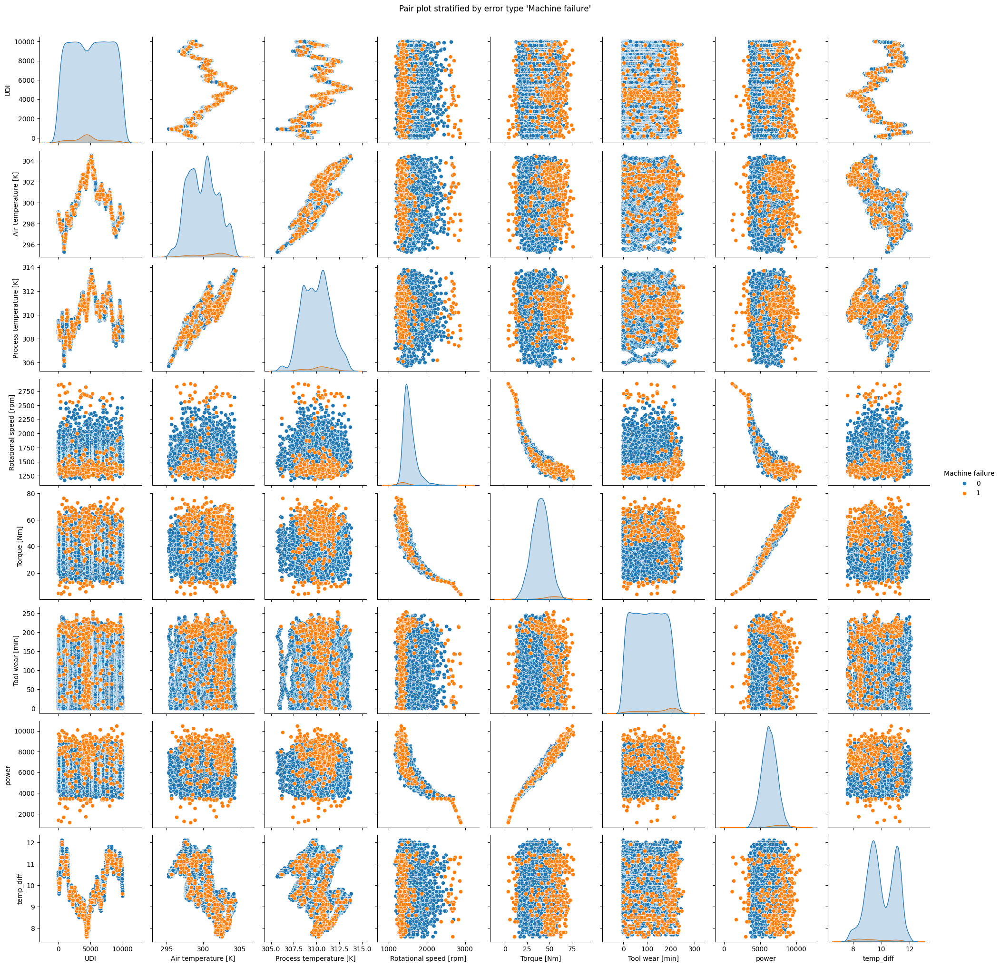

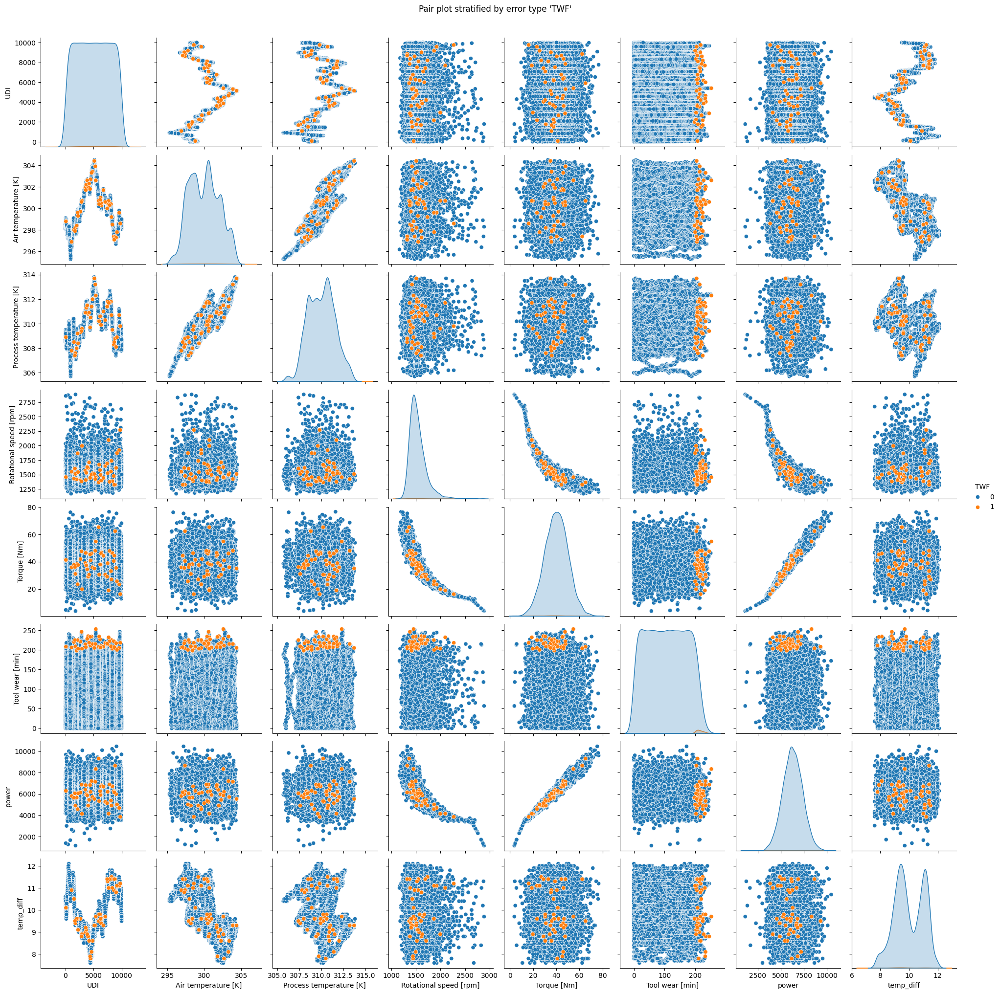

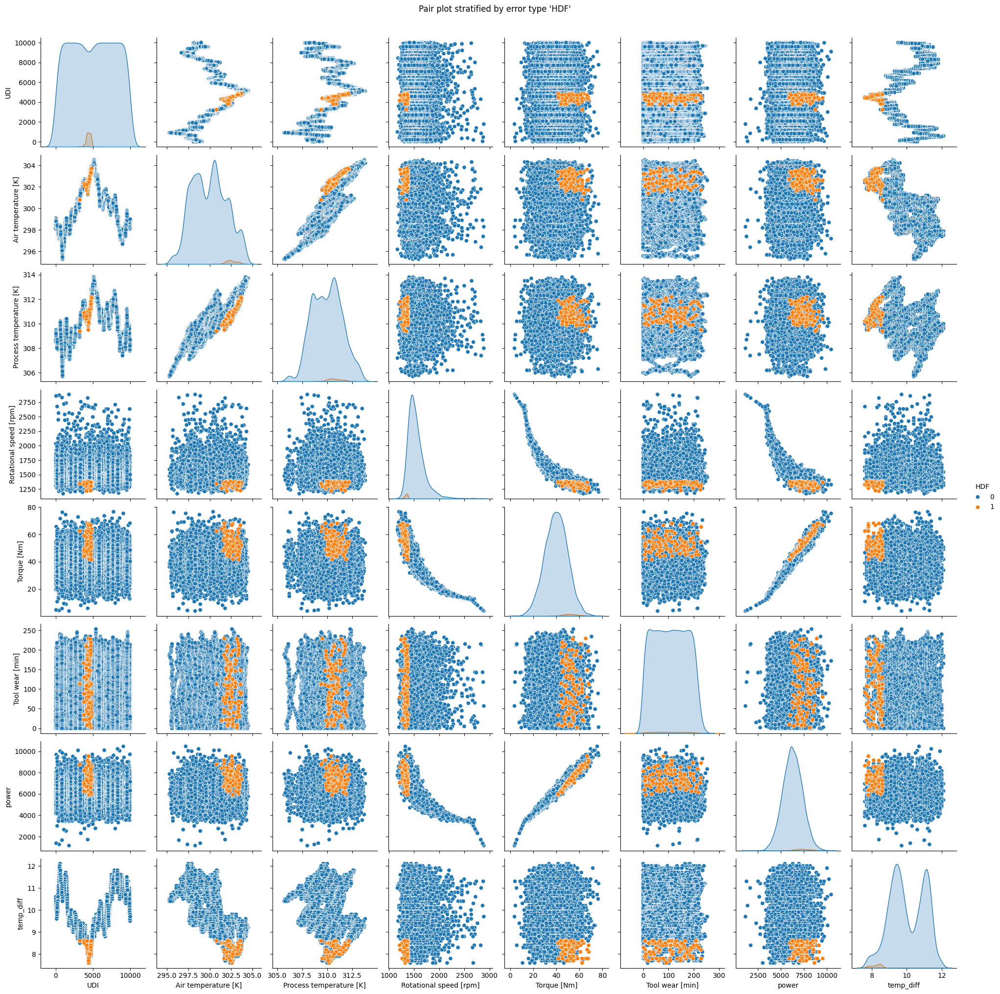

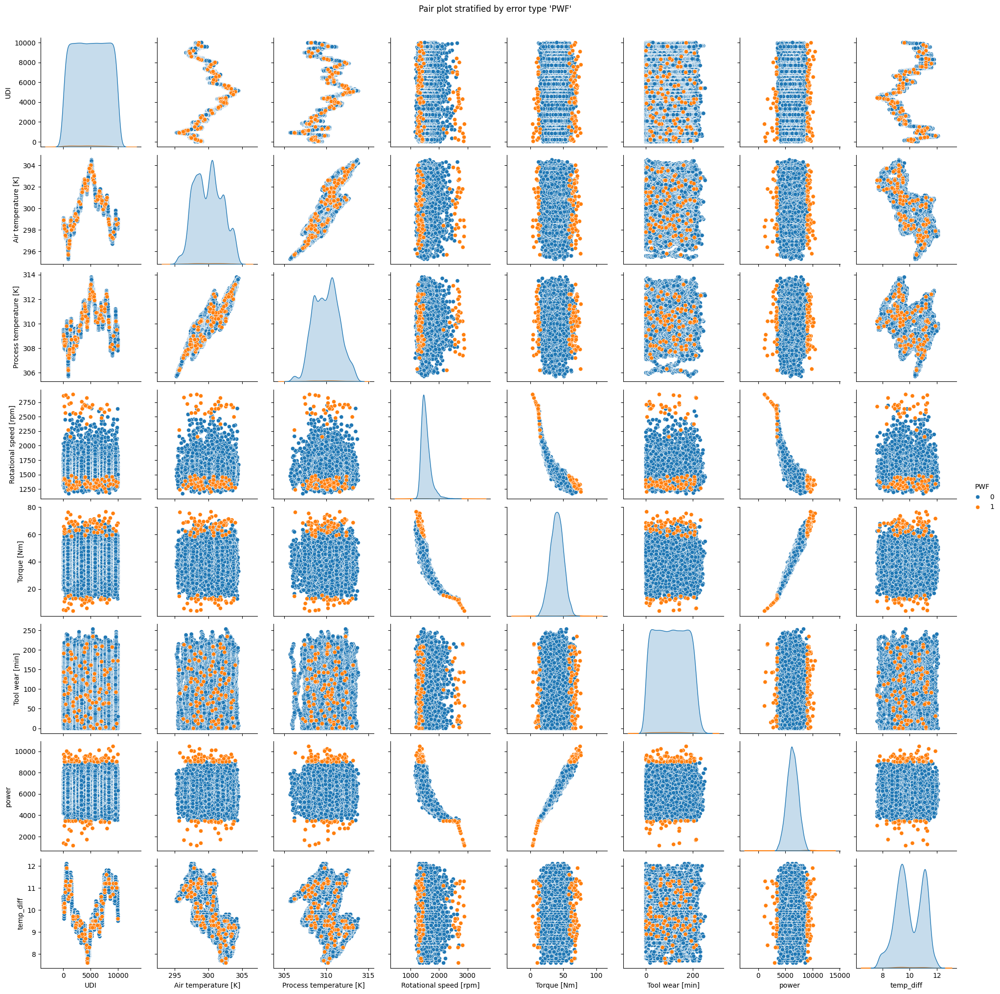

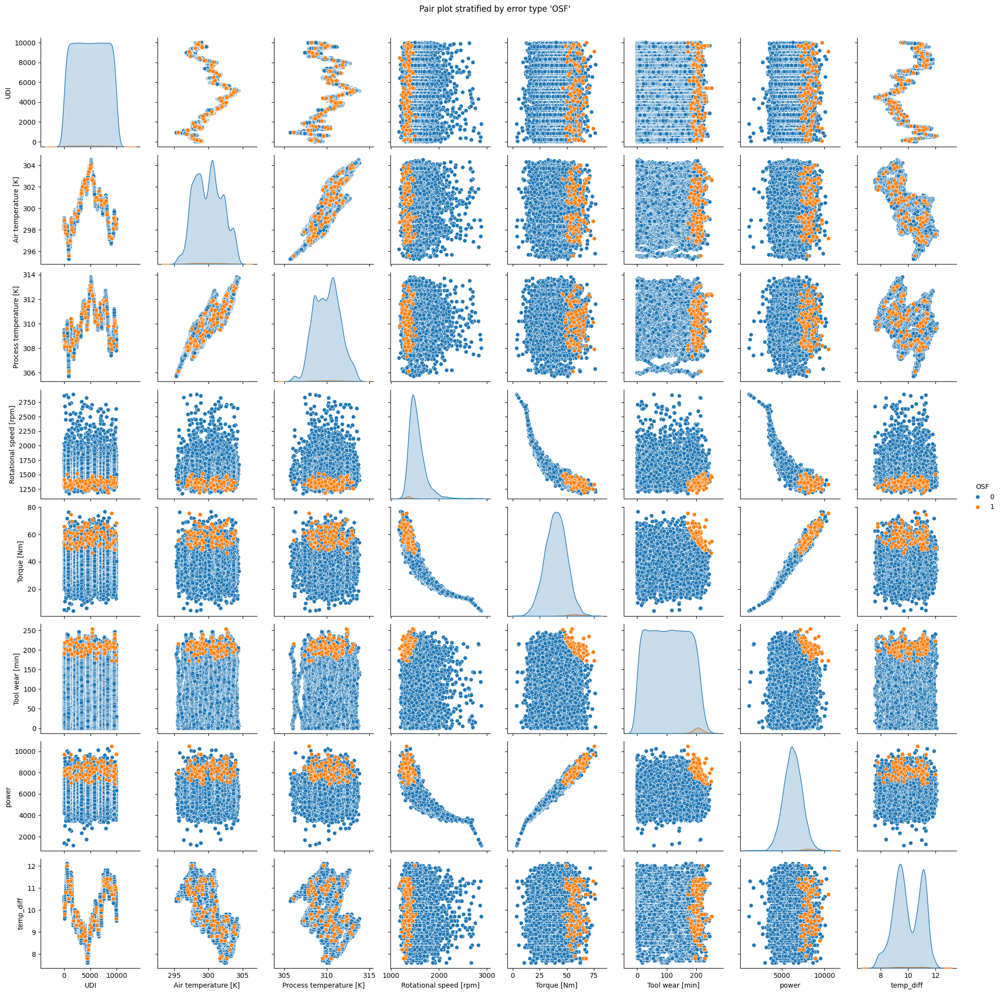

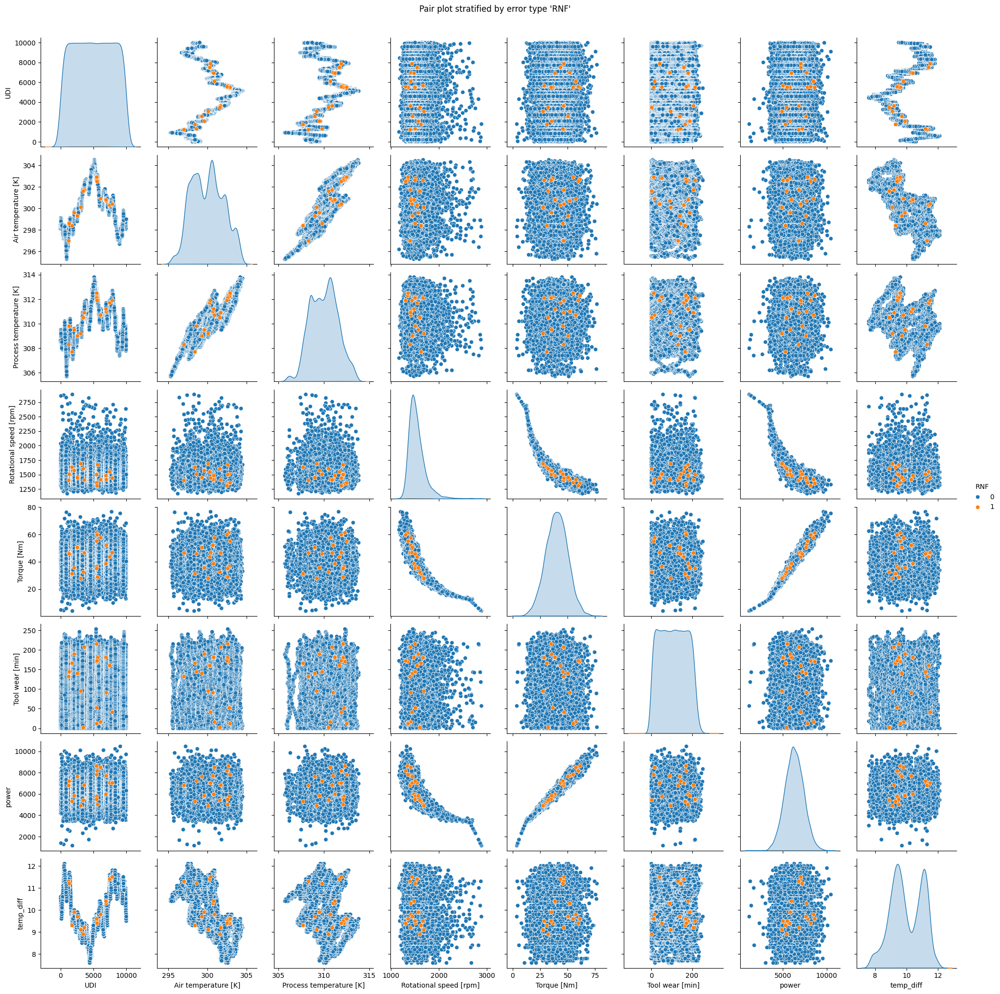

In [18]:
for col in ERROR_VARS:
    plot_pair_with_hue(df, col)

- The plot for `TWF` clearly indicates that the failure only appears for tool wear times exceeding 200 minutes.

- `HDF` occurs when rotational speed is small and difference between air temperature and machine temperature is low.

- `PWF` clearly occurs when power is smaller than ca. 4000 or higher than 9000.

- `OSF` is likely when torque and tool wear are elevated.

- `RNF` shows no clear pattern.

Alternatively, we could also use a simple explainable AI model to identify the key factors contributing to each failure type.
Let us explore this approach with decision trees.
Check the titles of the plots and interpret the results.

In [19]:
def plot_decision_tree(df, target_col, feature_cols=['Air temperature [K]', 'Process temperature [K]', 'Rotational speed [rpm]', 'Torque [Nm]', 'Tool wear [min]', 'temp_diff', 'power']):
    X = df[feature_cols]
    y = df[target_col]
    
    tree = skt.DecisionTreeClassifier(max_depth=3, random_state=42, min_samples_split=5, min_samples_leaf=5)
    tree.fit(X, y)
    
    plt.figure(figsize=(20, 20))
    skt.plot_tree(tree, feature_names=feature_cols, class_names=["OK", "ERR"], filled=True, rounded=True)
    plt.title(f'Decision Tree for {target_col} -- Samples with error: {y.sum()}')
    plt.show()

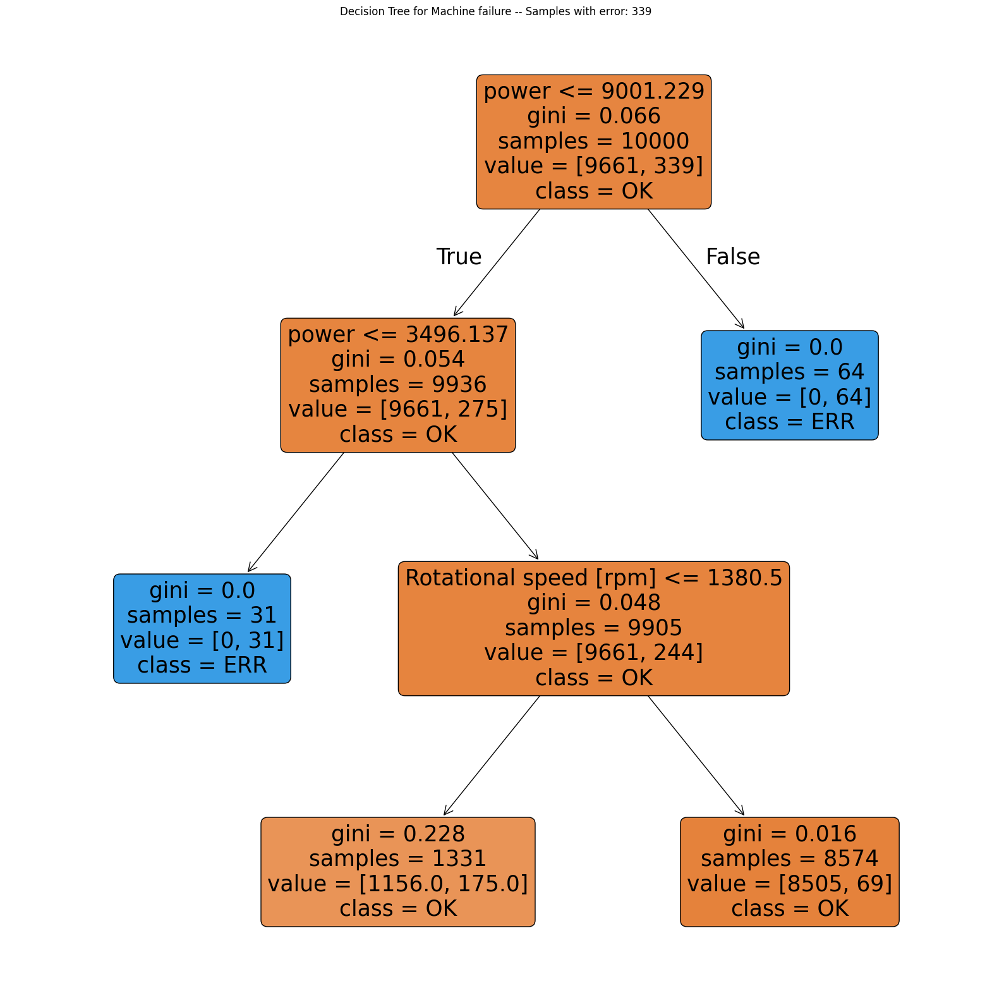

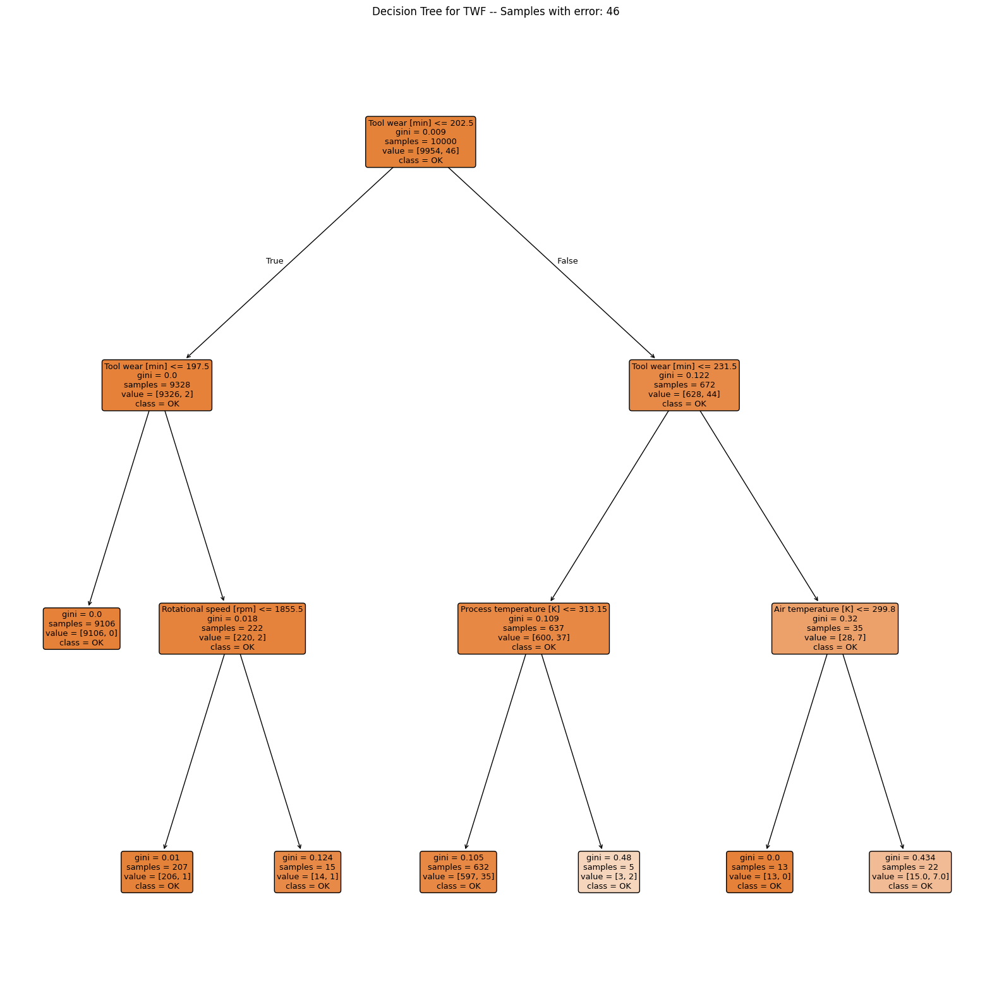

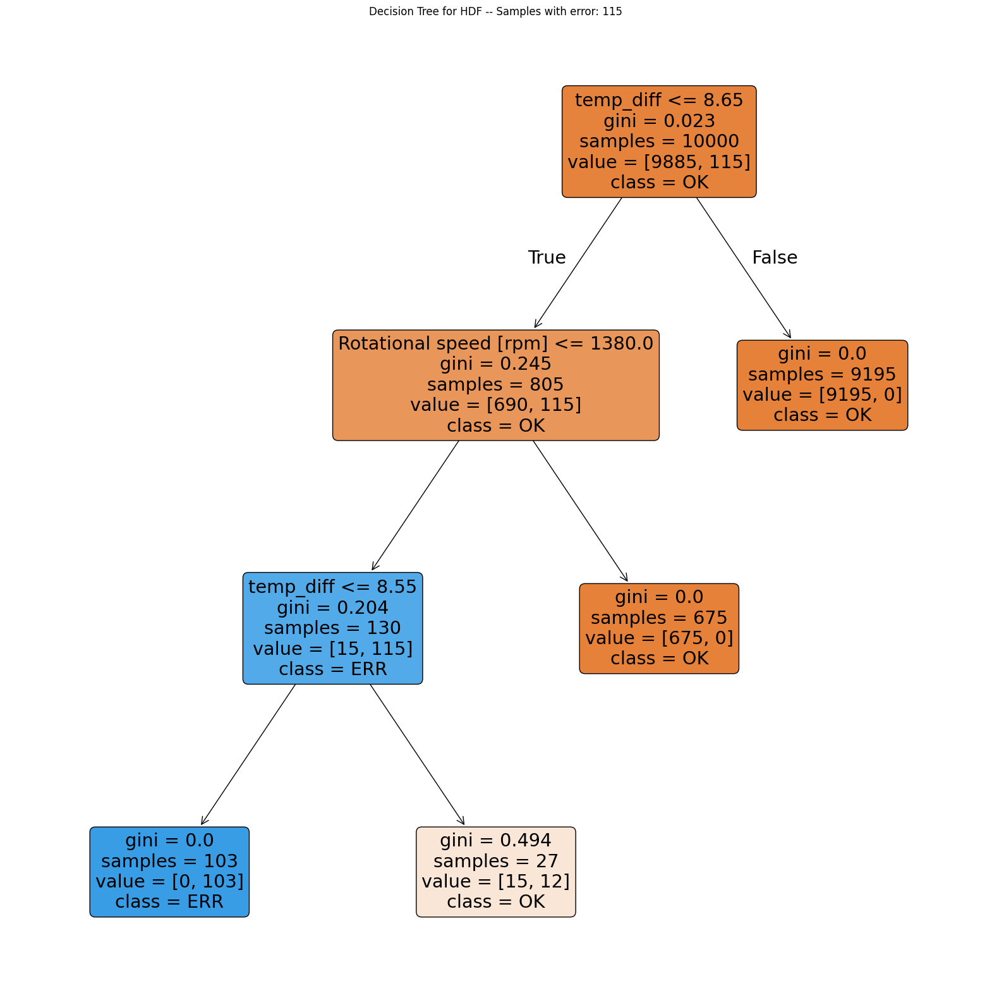

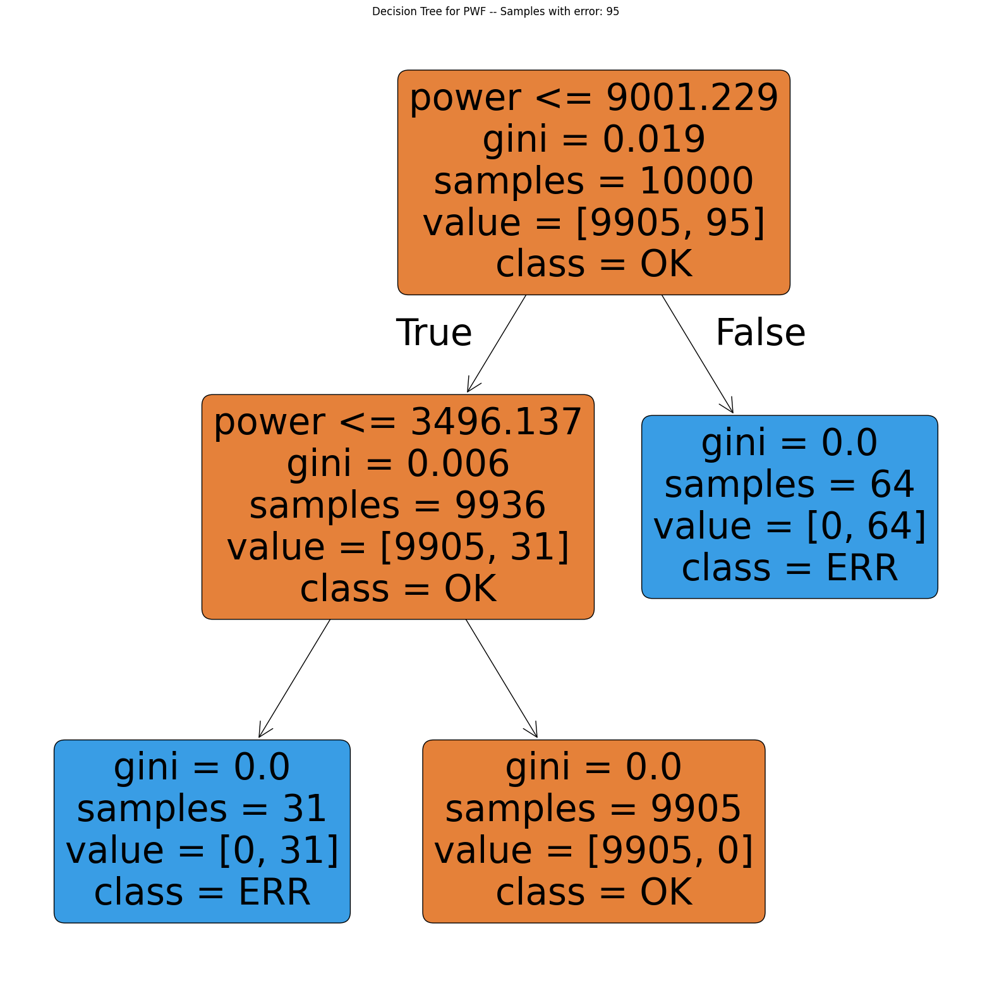

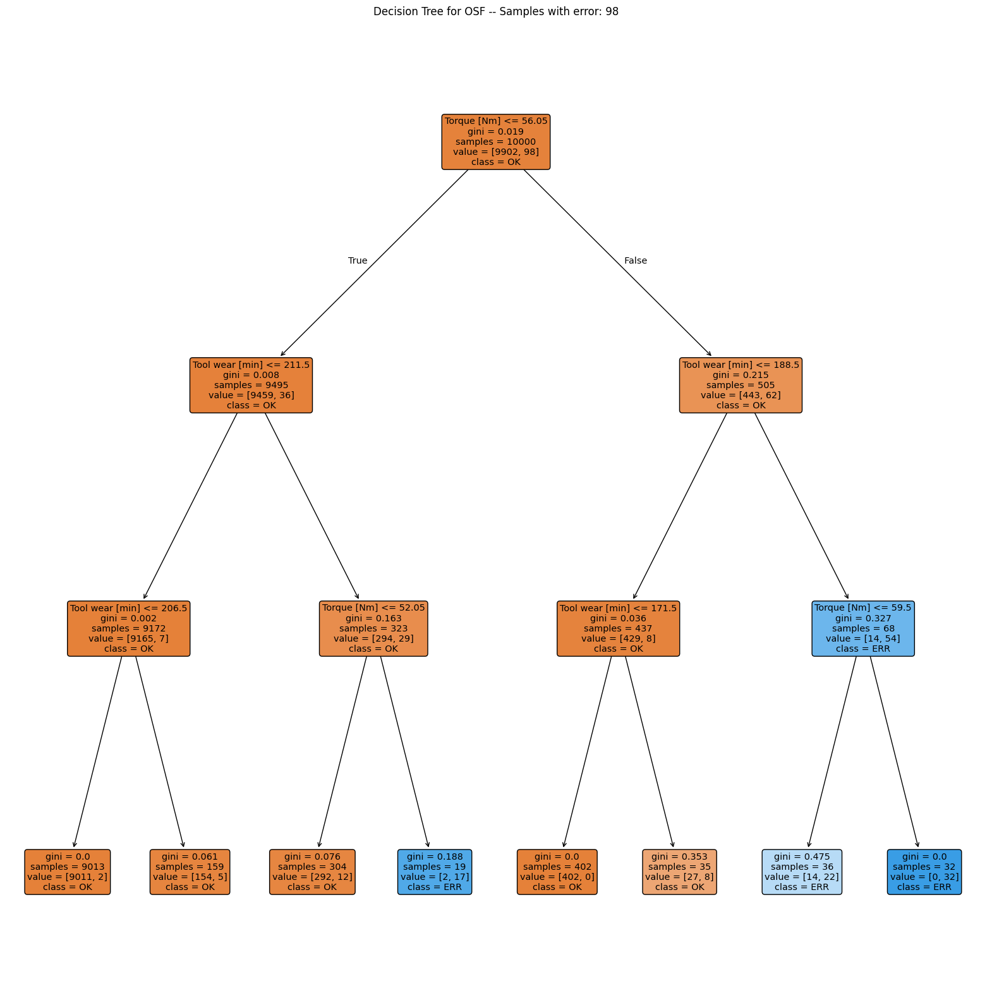

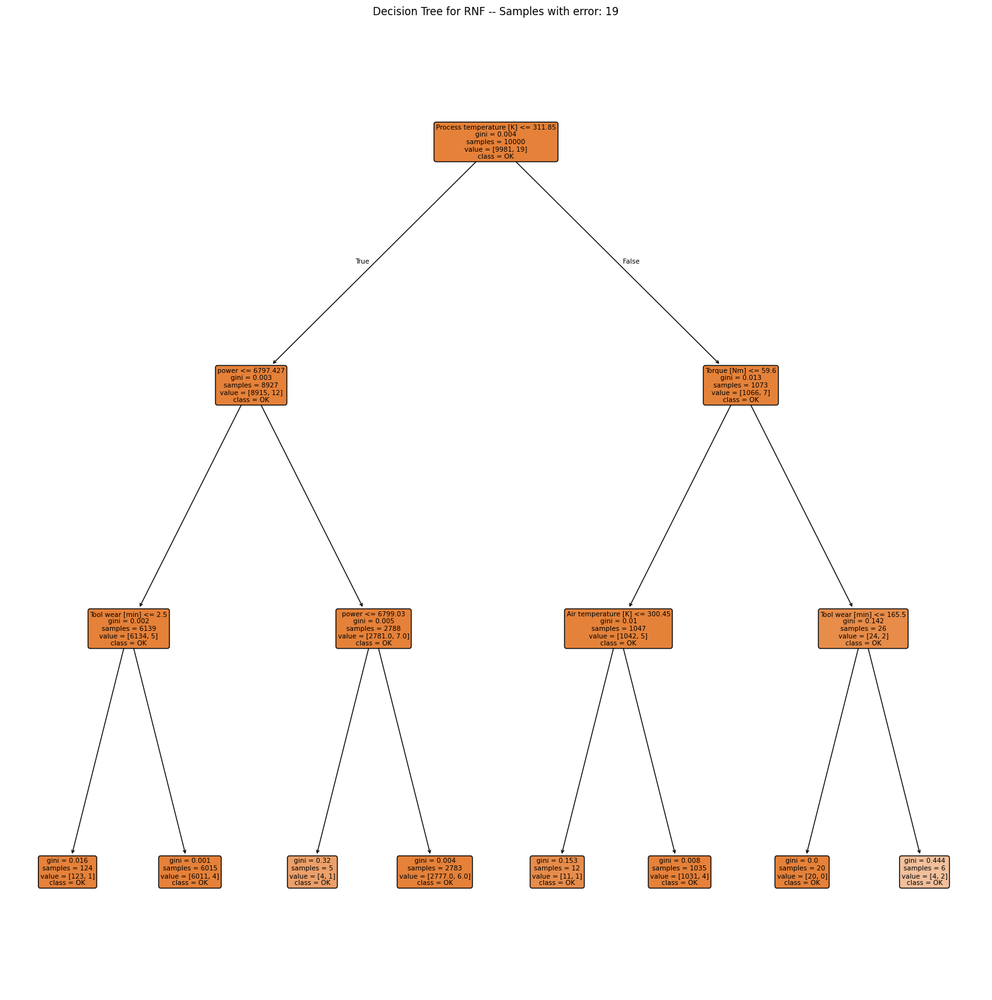

In [20]:
for col in ERROR_VARS:
    plot_decision_tree(df, col)

- `TWF`: Although the classification performs poorly, the first split is made along the tool wear time (value 202.5).
For smaller values the process only fails in 2 out of 9328 cases.

- `HDF`: Clearly shows that the failure usually occurs when temperature difference is below 8.65 and rotational speed is slower than 1380rpm.

- `PWF`: Occurs when power exceeds 9001 W or is lower than 3496 W.

- `OSF`: The decision tree alternately looks at tool wear and torque but is not able to find a good model with a depth of 3.
Note that the decision tree is only able to make horizontal or vertical cuts and is therefor sensitive to rotations of the given data.
This indicates, that tool wear and torque are the main drivers of the `OSF` machine failure type but a simple decision tree is not able to model this relationship.

- `RNF`: The model completely fails and shows no pattern.

Please note that the conclusions are quite similar to the ones we made on base of the pairplots.

## The great reveal

The documentation of the dataset also describes the error types as follows:
- tool wear failure (`TWF`): the tool will be replaced of fail at a randomly selected tool wear time between 200 and 240 mins (120 times in our dataset).
At this point in time, the tool is replaced 69 times, and fails 51 times (randomly assigned).

- heat dissipation failure (`HDF`): heat dissipation causes a process failure, if the difference between air- and process temperature is below 8.6 K and the tool's rotational speed is below 1380 rpm. This is the case for 115 data points.

- power failure (`PWF`): the product of torque and rotational speed (in rad/s) equals the power required for the process.
If this power is below 3500 W or above 9000 W, the process fails, which is the case 95 times in our dataset.

- overstrain failure (`OSF`): if the product of tool wear and torque exceeds 11.000 minNm for the L product variant (12.000 for M, 13.000 for H), the process fails due to overstrain. This is true for 98 datapoints.

- random failures (`RNF`): each process has a chance of 0.1 % to fail regardless of its process parameters. This is the case for only 5 datapoints, less than could be expected for 10,000 datapoints in our dataset.

## Conclusion

Many roads lead to Rome.
We successfully recovered most of the key factors for failure from the dataset, using clever visualizations and making use of promising AI tools.

These insights can help improving the reliability of the processes and reduce the likelihood of failures in the future.
E.g. the tool wear failure could be mitigated by implementing more frequent tool replacements, while the heat dissipation failure could be addressed by not allowing rotational speeds below 1380rpm.
The power failure could be prevented by ensuring that the product of torque and rotational speed stays within the specified limits, and the overstrain failure could be avoided by monitoring the tool wear and torque closely.